# Поиск по изображениям

Пользователи фотохостинга для профессиональных фотографов «Со Смыслом» (“With Sense”) размещают свои фотографии и сопровождают их полным описанием: указывают место съёмок, модель камеры и т. д. Отличительная особенность сервиса — описание: его может предоставить не только тот, кто размещает фотографию, но и другие пользователи портала.

Ваш отдел занимается экспериментом по разработке поиска референсных фотографий для фотографов. Суть поиска заключается в следующем: пользователь сервиса вводит описание нужной сцены.

**Цель:** создать и выбрать лучшую  модель, которая получит векторное представление изображения, векторное представление текста, а на выходе выдаст число от 0 до 1 — и покажет, насколько текст и картинка подходят друг другу, исключить из поисковых материалов детей младше 16 лет.

**Задачи:**
1. Загрузка и исследовательский анализ данных.
2. Подготовка данных к обучению.
3. Обучение модели.
4. Тестирование и демонстрация работы модели.
5. Общий вывод.

# Описание данных

Данные представлены в виде 6 файлов.  

1. `train_dataset.csv` - находится информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний.;
2. Папка `train_images` - изображения для тренировки модели;
3. `CrowdAnnotations.tsv` - данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:
    * Имя файла изображения.
    * Идентификатор описания.
    * Доля людей, подтвердивших, что описание соответствует изображению.
    * Количество человек, подтвердивших, что описание соответствует изображению.
    * Количество человек, подтвердивших, что описание не соответствует изображению.
4. `ExpertAnnotations.tsv` -  данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:
    * Имя файла изображения.
    * Идентификатор описания.
    * 3, 4, 5 — оценки трёх экспертов.

*Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.*

5. `test_queries.csv` - информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний;
6. Папка `test_images` -  изображения для тестирования модели.



# Шаг 1. Загрузка и исследовательский анализ данных

In [ ]:
import os
from pathlib import Path
import random
import re
import spacy
import nltk
import zipfile

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.models as models
from torch.utils.data import DataLoader, TensorDataset

from PIL import Image
from nltk.probability import FreqDist
from nltk.corpus import stopwords
from transformers import AutoModel, AutoTokenizer

from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GroupShuffleSplit, GridSearchCV
from sklearn.compose import ColumnTransformer
from google.colab import files
from google.colab import drive
from torchvision import transforms, models

In [ ]:
drive.mount('/content/drive')

zip_path = '/content/drive/MyDrive/dsplus_integrated_project_4.zip'
extract_path = '/content/dsplus_integrated_project_4'

Path(extract_path).mkdir(parents=True, exist_ok=True)
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print('Файлы распакованы в:', extract_path)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Файлы распакованы в: /content/dsplus_integrated_project_4


In [ ]:
RANDOM_STATE = 42
DATA_PATH = Path('/content/dsplus_integrated_project_4/to_upload')
TRAIN_IMAGES_PATH = DATA_PATH / 'train_images'
TEST_IMAGES_PATH = DATA_PATH / 'test_images'

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Используем устройство:', device)

Используем устройство: cuda


In [ ]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 10)

Загрузим датафреймы.

In [ ]:
train_df = pd.read_csv(DATA_PATH / 'train_dataset.csv')
print('Train dataset:')
display(train_df.head())
train_df.info()

Train dataset:


,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


In [ ]:
query_df = pd.read_csv(DATA_PATH / 'test_queries.csv', sep='|')
print('Query df:')
display(query_df.head())
query_df.info()

Query df:


,Unnamed: 0,query_id,query_text,image
0,0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  500 non-null    int64 
 1   query_id    500 non-null    object
 2   query_text  500 non-null    object
 3   image       500 non-null    object
dtypes: int64(1), object(3)
memory usage: 15.8+ KB


In [ ]:
expert_df = pd.read_csv(DATA_PATH / 'ExpertAnnotations.tsv', sep='\t', header=None,
                        names=['image','query_id','e1','e2','e3'])
print('\nExpert annotations:')
display(expert_df.head())
expert_df.info()


Expert annotations:


,image,query_id,e1,e2,e3
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     5822 non-null   object
 1   query_id  5822 non-null   object
 2   e1        5822 non-null   int64 
 3   e2        5822 non-null   int64 
 4   e3        5822 non-null   int64 
dtypes: int64(3), object(2)
memory usage: 227.6+ KB


In [ ]:
test_df = pd.read_csv(DATA_PATH / 'test_images.csv')
print('\nTest df:')
display(test_df.head())
test_df.info()


Test df:


,image
0,3356748019_2251399314.jpg
1,2887171449_f54a2b9f39.jpg
2,3089107423_81a24eaf18.jpg
3,1429546659_44cb09cbe2.jpg
4,1177994172_10d143cb8d.jpg


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   100 non-null    object
dtypes: object(1)
memory usage: 932.0+ bytes


In [ ]:
crowd_df = pd.read_csv(DATA_PATH / 'CrowdAnnotations.tsv', sep='\t', header=None,
    names=['image', 'query_id', 'prop', 'yes', 'no'])
display(crowd_df.head())
crowd_df.info()

,image,query_id,prop,yes,no
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0,3,0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.0,0,3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.0,0,3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.0,0,3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.0,0,3


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   image     47830 non-null  object 
 1   query_id  47830 non-null  object 
 2   prop      47830 non-null  float64
 3   yes       47830 non-null  int64  
 4   no        47830 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB


In [ ]:
print('Train dataset размер:', train_df.shape)
print('Количество уникальных изображений:', train_df['image'].nunique())
print('Количество уникальных идентификаторов описаний:', train_df['query_id'].nunique())
print('Количество уникальных  описаний:', train_df['query_text'].nunique())
print('___________________________________')

print('Crowd dataset размер:', crowd_df.shape)
print('Доля людей, подтвердивших, что описание соответствует изображению:', crowd_df['prop'].describe())
print('___________________________________')

expert_df['mean_score'] = expert_df[['e1','e2','e3']].mean(axis=1)
print('Expert dataset размер:', expert_df.shape)
print('Средняя оценка экспертов:', expert_df['mean_score'].describe())
print('___________________________________')

print('Test dataset размер:', test_df.shape)
print('Количество уникальных идентификаторов изображений:', test_df['image'].nunique())
print('___________________________________')

desc_per_image = query_df.groupby('image')['query_id'].count()
print('Query dataset размер:', query_df.shape)
print('Количество уникальных идентификаторов описаний:', query_df['query_id'].nunique())
print('Количество уникальных идентификаторов изображений:', query_df['image'].nunique())
print('Среднее количество описаний на одно изображение:', desc_per_image.mean())
print('Минимум и максимум описаний на одно изображение:', desc_per_image.min(), desc_per_image.max())

Train dataset размер: (5822, 3)
Количество уникальных изображений: 1000
Количество уникальных идентификаторов описаний: 977
Количество уникальных  описаний: 977
___________________________________
Crowd dataset размер: (47830, 5)
Доля людей, подтвердивших, что описание соответствует изображению: count    47830.000000
mean         0.068786
std          0.207532
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
Name: prop, dtype: float64
___________________________________
Expert dataset размер: (5822, 6)
Средняя оценка экспертов: count    5822.000000
mean        1.647658
std         0.806205
min         1.000000
25%         1.000000
50%         1.333333
75%         2.000000
max         4.000000
Name: mean_score, dtype: float64
___________________________________
Test dataset размер: (100, 1)
Количество уникальных идентификаторов изображений: 100
___________________________________
Query dataset размер: (500, 4)
Количество уника

Во всех данных отсутсвуют пропуски.

**train_df**
* Размер: 5822 строк × 3 колонки (image, query_id, query_text)
* Уникальных изображений: 1000
* Уникальных описаний (query_id / query_text): 977
* Некоторые описания повторяются для разных изображений
* Одно изображение может иметь до 5 описаний
* Для модели нужно использовать пары (image + query_id) как уникальные строки

**сrowd_df**
* Размер: 47830 строк × 5 колонок (image, query_id, prop, yes, no)
* Доля подтверждённых описаний (prop): Среднее ≈ 0.069, Медиана = 0 (большинство описаний не подтверждаются людьми), Мин = 0, макс = 1
* Данные шумные, не всегда отражают экспертную оценку

**expert_df**
* Размер: 5822 строк × 6 колонок (image, query_id, e1, e2, e3, mean_score)
* Средняя оценка экспертов: 1.65 (шкала 1–4), Медиана = 1.33 (большинство описаний слабо соответствуют изображению)

**test_df**
* 100 уникальных изображений

**query_df**
* Размер: 500 строк × 4 колонки (Unnamed: 0, query_id, query_text, image)
* Уникальных query_id: 500
* Уникальных изображений: 100
* Каждый запрос (текст) имеет своё релевантное изображение
* На одно изображение приходится стабильно 5 текстов

Проверим порядковые номера описаний.

In [ ]:
def extract_order_number(df, col='query_id'):
    return df[col].str.split('#').str[1]

train_df['order_num'] = extract_order_number(train_df, 'query_id')
print('train_df — уникальные порядковые номера описаний:', sorted(train_df['order_num'].unique()))
print('------')

crowd_df['order_num'] = extract_order_number(crowd_df, 'query_id')
print('сrowd_df — уникальные порядковые номера описаний:', sorted(crowd_df['order_num'].unique()))
print('------')

expert_df['order_num'] = extract_order_number(expert_df, 'query_id')
print('expert_df — уникальные порядковые номера описаний:', sorted(expert_df['order_num'].unique()))
print('------')

query_df['order_num'] = extract_order_number(query_df, 'query_id')
print('query_df — уникальные порядковые номера описаний:', sorted(query_df['order_num'].unique()))
print('------')

train_df — уникальные порядковые номера описаний: ['2']
------
сrowd_df — уникальные порядковые номера описаний: ['2']
------
expert_df — уникальные порядковые номера описаний: ['2']
------
query_df — уникальные порядковые номера описаний: ['0', '1', '2', '3', '4']
------


Во всех датафреймах используется второе описание, кроме итогового тестового, в котором используются все пять.

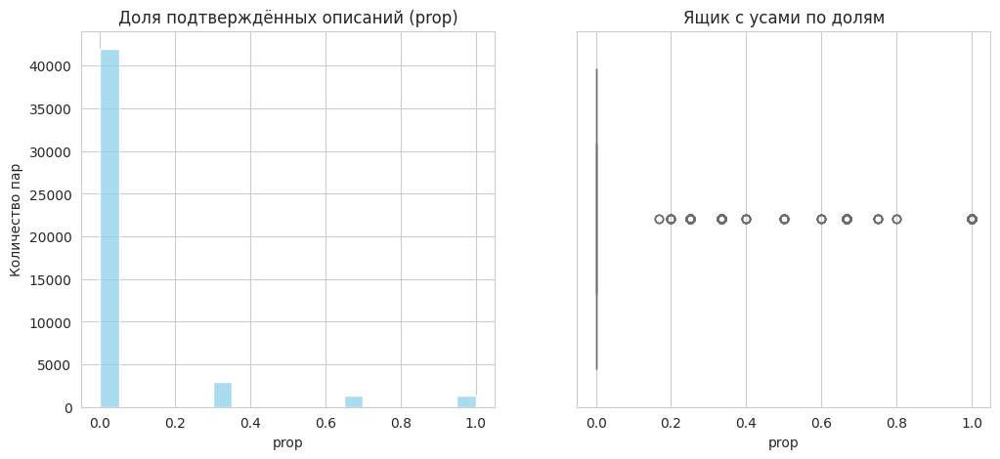

------


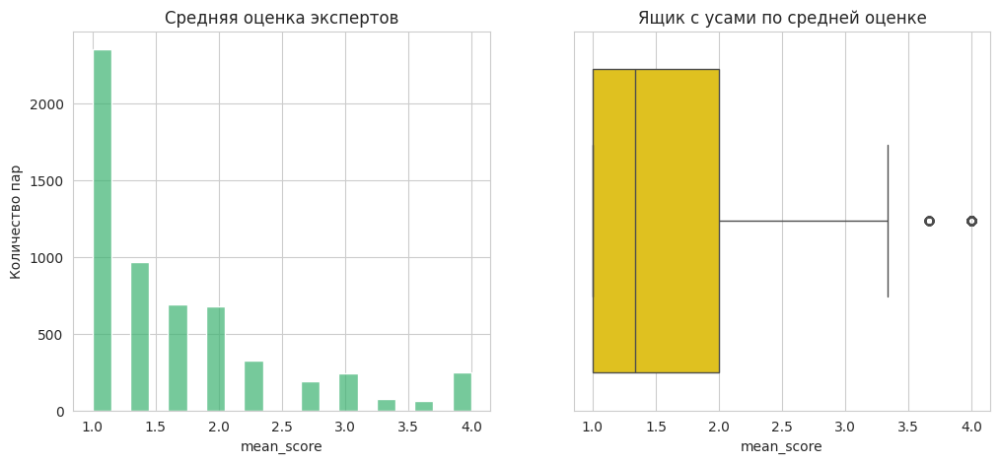

In [ ]:
sns.set_style('whitegrid')
sns.set_palette('Set2')
plt.rcParams['figure.figsize'] = (12,5)

plt.subplot(1,2,1)
sns.histplot(crowd_df['prop'], bins=20, kde=False, color='skyblue', alpha=0.7)
plt.title('Доля подтверждённых описаний (prop)')
plt.xlabel('prop')
plt.ylabel('Количество пар')

plt.subplot(1,2,2)
sns.boxplot(x=crowd_df['prop'], color='lightcoral')
plt.title('Ящик с усами по долям')

plt.show()
print('------')

plt.subplot(1,2,1)
sns.histplot(expert_df['mean_score'], bins=20, kde=False, color='mediumseagreen', alpha=0.7)
plt.title('Средняя оценка экспертов')
plt.xlabel('mean_score')
plt.ylabel('Количество пар')

plt.subplot(1,2,2)
sns.boxplot(x=expert_df['mean_score'], color='gold')
plt.title('Ящик с усами по средней оценке')

plt.show()

Наглядно видно, что эксперты мягче, чем краудинговая компания, оценили описания. Но все равно оценки нехорошие, модели будет тяжело даваться обучение.

Для оценки достоверности описания будем использовать взвешенное среднее с большими весами в сторону мнения экспертов, так как у них более разнообразные оценки за счет чего ниже шум в данных.

Так же, так как в оценке экспертов на 42 тыс. меньше данных: пропишем условия, что в случае отсутсвия оценки с одной из сторон, тогда используем ту оценку, что имеется в наличии.

In [ ]:
expert_df['expert_norm'] = (expert_df['mean_score'] - 1) / 3

merged_df = expert_df.merge(
    crowd_df[['image', 'query_id', 'prop']],
    on=['image', 'query_id'],
    how='outer'
)

def compute_target(row):
    if pd.notna(row['expert_norm']) and pd.notna(row['prop']):
        return 0.6 * row['expert_norm'] + 0.4 * row['prop']
    elif pd.notna(row['expert_norm']):
        return row['expert_norm']
    elif pd.notna(row['prop']):
        return row['prop']
    else:
        return 0.0

merged_df['target'] = merged_df.apply(compute_target, axis=1)

print(f"Target min: {merged_df['target'].min()}")
print(f"Target max: {merged_df['target'].max()}")

Target min: 0.0
Target max: 1.0


In [ ]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51323 entries, 0 to 51322
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   image        51323 non-null  object 
 1   query_id     51323 non-null  object 
 2   e1           5822 non-null   float64
 3   e2           5822 non-null   float64
 4   e3           5822 non-null   float64
 5   mean_score   5822 non-null   float64
 6   order_num    5822 non-null   object 
 7   expert_norm  5822 non-null   float64
 8   prop         47830 non-null  float64
 9   target       51323 non-null  float64
dtypes: float64(7), object(3)
memory usage: 3.9+ MB


Визуализируем то, что у нас получилось.

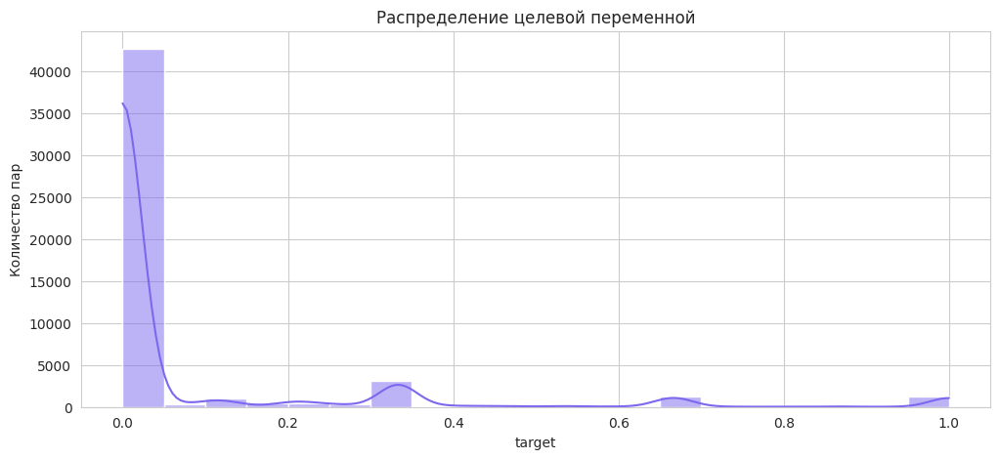

In [ ]:
sns.histplot(merged_df['target'], bins=20, kde=True, color='mediumslateblue')
plt.title('Распределение целевой переменной')
plt.xlabel('target')
plt.ylabel('Количество пар')
plt.show()

Распределение стало более наполненным, сохранились пропорции с перевесом в сторону низких оценок. Очень сильный перевес в сторону полного несоответсвия описаний.

Посмотрим на наши изображения.

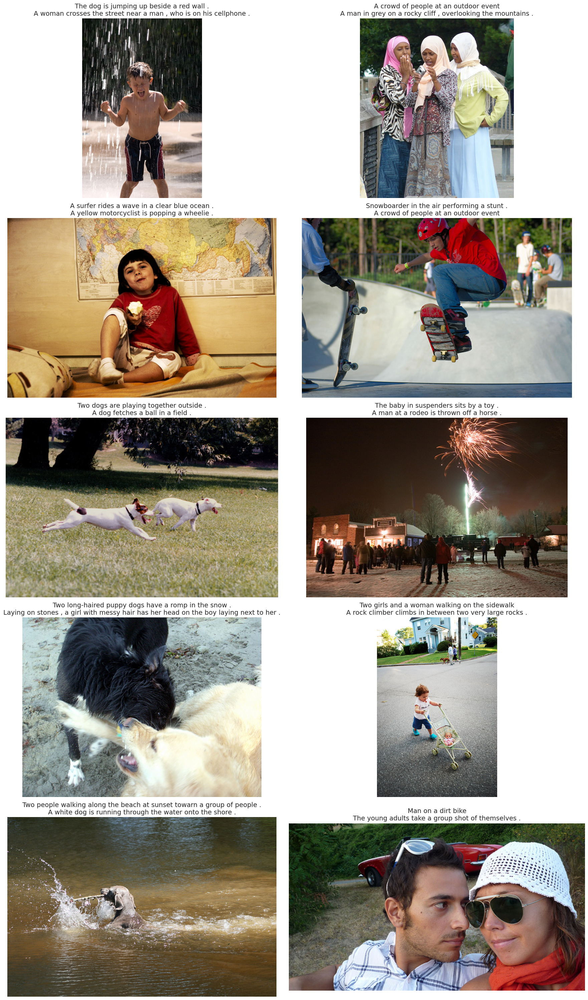

In [ ]:
sample_images = random.sample(list(train_df['image'].unique()), 10)

n_cols = 2
n_rows = (len(sample_images) + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 6 * n_rows))
axes = axes.flatten()

images = [Image.open(TRAIN_IMAGES_PATH / fname) for fname in sample_images]
captions = ['\n'.join(train_df.loc[train_df['image']==fname, 'query_text'].tolist()[:2])
            for fname in sample_images]

for ax, img, cap in zip(axes, images, captions):
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(cap, fontsize=14)

plt.tight_layout()
plt.show()

Теперь не возникает сомнений в адекватности низких оценок экспертов.

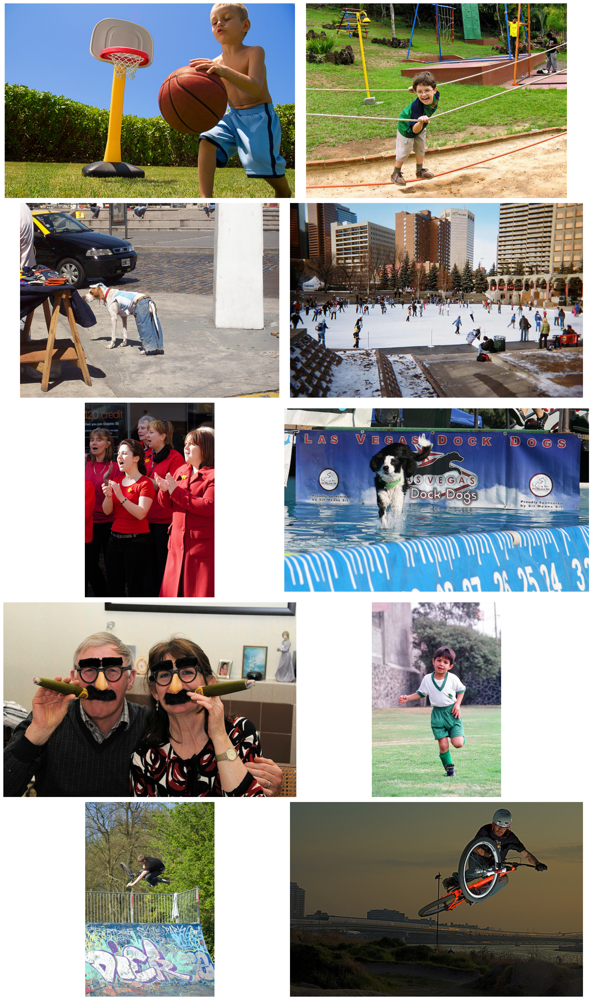

In [ ]:
sample_images = random.sample(list(test_df['image'].unique()), 10)

n_cols = 2
n_rows = (len(sample_images) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 6 * n_rows))
axes = axes.flatten()

images = [mpimg.imread(TEST_IMAGES_PATH / fname) for fname in sample_images]

for ax, img in zip(axes, images):
    ax.imshow(img)
    ax.axis('off')

plt.tight_layout()
plt.show()

Видно что много людей, детей и собак участвует в тестировании.

Объединим нормализированную оценку с итоговым тестовым датафреймом.

In [ ]:
train_df = train_df.drop('order_num', axis=1)
full_train_df = train_df.merge(
    merged_df[['image','query_id','target']],
    on=['image','query_id'],
    how='outer'
)

display(full_train_df.head())
full_train_df.info()

,image,query_id,query_text,target
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,NaN,1.0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,NaN,0.0
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,NaN,0.0
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,NaN,0.0
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,NaN,0.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51323 entries, 0 to 51322
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       51323 non-null  object 
 1   query_id    51323 non-null  object 
 2   query_text  5822 non-null   object 
 3   target      51323 non-null  float64
dtypes: float64(1), object(3)
memory usage: 1.6+ MB


Нужно восстановить query_text.

In [ ]:
empty = full_train_df[full_train_df['query_text'].notna()]
empty_map = empty.groupby('query_id')['query_text'].first()
full_train_df['query_text'] = full_train_df['query_text'].fillna(full_train_df['query_id'].map(empty_map))

full_train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51323 entries, 0 to 51322
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       51323 non-null  object 
 1   query_id    51323 non-null  object 
 2   query_text  50214 non-null  object 
 3   target      51323 non-null  float64
dtypes: float64(1), object(3)
memory usage: 1.6+ MB


Удалим строки для которых не нашлось данных для заполнения `query_text`.

In [ ]:
full_train_df = full_train_df.dropna()
full_train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50214 entries, 0 to 51322
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       50214 non-null  object 
 1   query_id    50214 non-null  object 
 2   query_text  50214 non-null  object 
 3   target      50214 non-null  float64
dtypes: float64(1), object(3)
memory usage: 1.9+ MB


Отлично, тренировочный датафрейм готов к заливке в модель.

## Промежуточный вывод

**Цель:** загрузить и исследовать данные.
1. Данные загружены в 5 датафремов `train_df`, `test_df`, `crowd_df`, `expert_df`, `query_df`, размеры установлены, пропуски и дубликаты отсутсвуют.
2. Во всех датафремах используется 2-ое описание изображений, кроме `query_df` в котором используются все 5.
3. Создан промежуточный датафрейм `merged_df` в поле которого проведена нормализация от 0 до 1 оценок экспертов и краудинговой компании при помощи взвешенного среднего в приоритетом в сторону оценок экспертов.
4. Создан `full_train_df` в котором 50214 строки и 4 столбца, включая нормализированные оценки в столбце `target`.

# Шаг 2. Подготовка данных к обучению

В некоторых странах, где работает наша компания, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно тексты, изображения, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16 лет. При попытке посмотреть изображения, запрещённые законодательством, вместо картинок будет показываться дисклеймер:

⎪ This image is unavailable in your country in compliance with local laws

Поэтому удалим все картинки с детьми из обучающего датафрейма.

Сначала токенизируем и лемматизируем тест используя Spacy.

In [ ]:
nlp = spacy.load('en_core_web_sm', disable=['ner', 'parser', 'textcat'])

def clean_and_lemmatize(texts):
    texts = [re.sub(r'[^a-z\s]', ' ', str(t).lower()) for t in texts]
    docs = nlp.pipe(texts, batch_size=500)

    token_lists = []   # списки токенов
    text_strings = []  # строки для моделей

    for doc in docs:
        toks = []
        for token in doc:
            if token.pos_ == 'PRON':
                toks.append(token.text)
            else:
                toks.append(token.lemma_)
        token_lists.append(toks)
        text_strings.append(' '.join(toks))

    return token_lists, text_strings

In [ ]:
%time
full_train = full_train_df.copy()
query = query_df.copy()

tokens_train, text_clean_train = clean_and_lemmatize(full_train['query_text'].tolist())
tokens_query, text_clean_query = clean_and_lemmatize(query['query_text'].tolist())

full_train['text_clean'] = text_clean_train
query['text_clean'] = text_clean_query

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 7.39 µs


In [ ]:
print(full_train.shape)
print(query.shape)

(50214, 5)
(500, 6)


Почистим от стоп слов.

In [ ]:
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Проведем частотный анализ.

In [ ]:
full_train['tokens'] = [tokens_train[i] for i in range(len(full_train))]
full_train['tokens'] = full_train['tokens'].apply(lambda toks: [t for t in toks if t not in stop_words and t.strip()])

def get_top_words(df, top_n=30):
    all_tokens = [tok for toks in df['tokens'] for tok in toks]
    dfist = FreqDist(all_tokens)
    top = dfist.most_common(top_n)
    df_top = pd.DataFrame(top, columns=['Слово', 'Количество'])
    return df_top

top_words = get_top_words(full_train, top_n=30)
print(top_words.head())

   Слово  Количество
0    dog       15924
1    man       11165
2    two        8556
3  white        6635
4   girl        5866


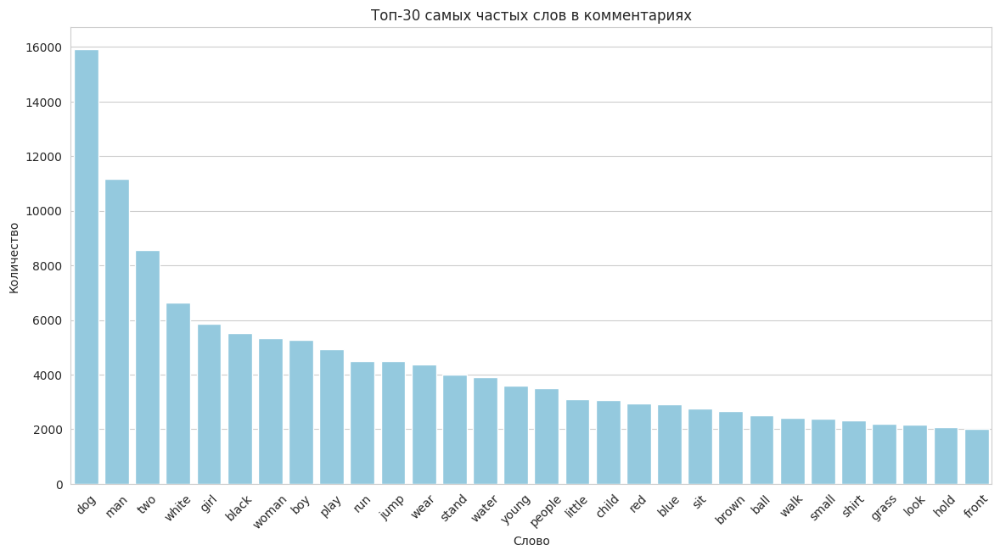

In [ ]:
plt.figure(figsize=(14,7))
sns.barplot(data=top_words, x='Слово', y='Количество', color='skyblue')
plt.title('Топ-30 самых частых слов в комментариях')
plt.xticks(rotation=45)
plt.show()

Итак, у нас очень много собачек. Из `запрещенного` в комментариях часто встречаются слова "boy", "girl", "child".    
Почистим тексты.

In [ ]:
danger = [
    'teen', 'teenager', 'teenagers',
    'child', 'children',
    'kid', 'kids',
    'toddler', 'toddlers',
    'baby', 'babies',
    'boy', 'boys', 'girl', 'girls',
    'youth', 'youths',
]

danger_lower = [w.lower() for w in danger]
def contains_danger_tokens(tokens):
    return any(tok.lower() in danger_lower for tok in tokens)

danger_rows = full_train[full_train['tokens'].apply(contains_danger_tokens)]

danger_list = danger_rows['query_id'].str[:-2].unique()

full_train_filtered = full_train[~full_train['query_id'].str[:-2].isin(danger_list)].reset_index(drop=True)

print(f'Удалено {len(full_train) - len(full_train_filtered)} записей с упоминанием несовершеннолетних')

Удалено 14389 записей с упоминанием несовершеннолетних


In [ ]:
all_tokens = [tok for toks in full_train_filtered['tokens'] for tok in toks]

dfist = FreqDist(all_tokens)
top_words = dfist.most_common(30)
df_top = pd.DataFrame(top_words, columns=['Слово', 'Количество'])
print(df_top.tail())

    Слово  Количество
25   look        1479
26   blue        1450
27  beach        1356
28   snow        1313
29  three        1305


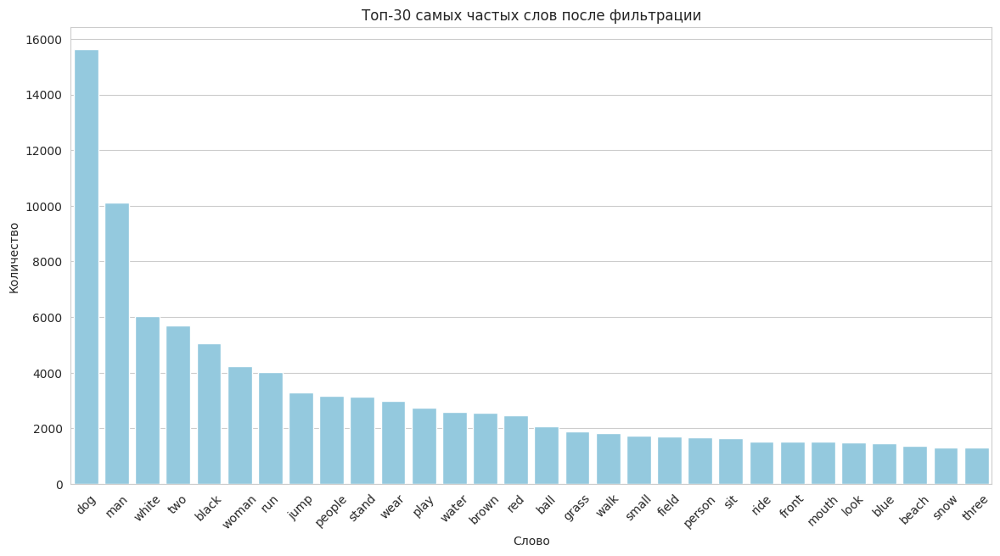

In [ ]:
plt.figure(figsize=(14,7))
sns.barplot(data=df_top, x='Слово', y='Количество', color='skyblue')
plt.title('Топ-30 самых частых слов после фильтрации')
plt.xticks(rotation=45)
plt.show()


In [ ]:
full_train_filtered.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35825 entries, 0 to 35824
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       35825 non-null  object 
 1   query_id    35825 non-null  object 
 2   query_text  35825 non-null  object 
 3   target      35825 non-null  float64
 4   text_clean  35825 non-null  object 
 5   tokens      35825 non-null  object 
dtypes: float64(1), object(5)
memory usage: 1.6+ MB


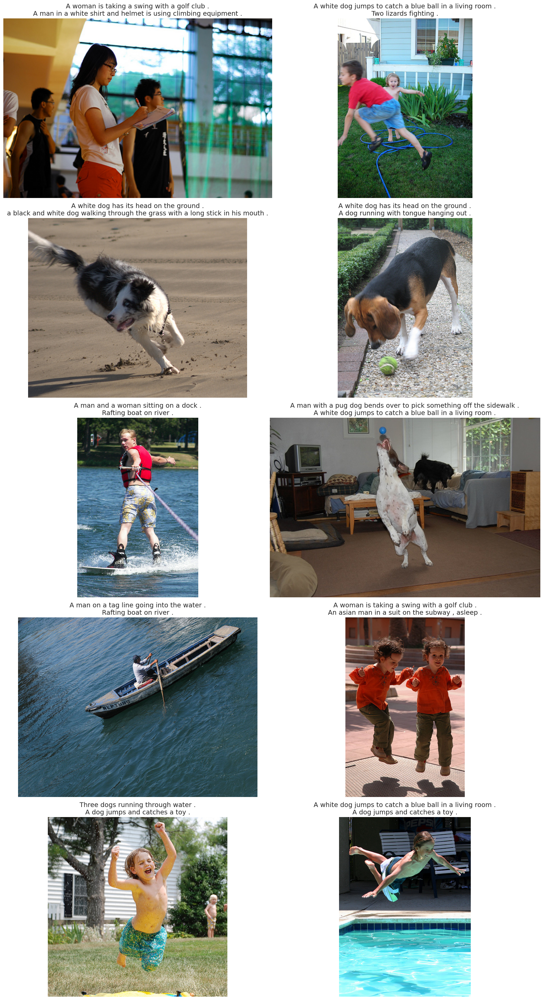

In [ ]:
sample_images = random.sample(list(full_train_filtered['image'].unique()), 10)

n_cols = 2
n_rows = (len(sample_images) + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 6 * n_rows))
axes = axes.flatten()

images = [Image.open(TRAIN_IMAGES_PATH / fname) for fname in sample_images]
captions = [
    '\n'.join(full_train_filtered.loc[full_train_filtered['image'] == fname, 'query_text'].tolist()[:2])
    for fname in sample_images
]

for ax, img, cap in zip(axes, images, captions):
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(cap, fontsize=14)

plt.tight_layout()
plt.show()

В случайных описаниях действительно отсутсвуют несовершеннолетние, но, до сих пор существует проблема в несоотствующих описаниях, поэтому фотографии с детьми еще присутсвуют в нашей выборке.

Фильтрация осуществлена. Проведем векторизацию при помощи эмбеддингов BERT, выберем модель `all-mpnet-base-v2`.

In [ ]:
def get_embeddings(texts, model, tokenizer, device='cuda', batch_size=64):
    """
    Вычисляет эмбеддинги для списка текстов с использованием SentenceTransformer модели.

    Параметры:
    - texts: list[str] — список текстов
    - model: HuggingFace модель
    - tokenizer: HuggingFace токенизатор
    - device: 'cpu' или 'cuda'
    - batch_size: размер батча для обработки

    Возвращает:
    - embeddings: torch.Tensor размера (len(texts), hidden_size)
    """
    model = model.to(device)
    model.eval()

    all_embeddings = []

    for i in range(0, len(texts), batch_size):
        batch_texts = texts[i:i+batch_size]

        encoded_input = tokenizer(
            batch_texts,
            padding=True,
            truncation=True,
            return_tensors='pt'
        ).to(device)

        with torch.no_grad():
            model_output = model(**encoded_input)

        attention_mask = encoded_input['attention_mask']
        token_embeddings = model_output.last_hidden_state
        input_mask_expanded = attention_mask.unsqueeze(-1).expand(token_embeddings.size()).float()
        sum_embeddings = torch.sum(token_embeddings * input_mask_expanded, 1)
        sum_mask = torch.clamp(input_mask_expanded.sum(1), min=1e-9)
        batch_embeddings = (sum_embeddings / sum_mask).cpu()

        all_embeddings.append(batch_embeddings)

    embeddings = torch.cat(all_embeddings, dim=0)
    return embeddings

tokenizer = AutoTokenizer.from_pretrained('sentence-transformers/all-mpnet-base-v2')
model_text = AutoModel.from_pretrained('sentence-transformers/all-mpnet-base-v2')

texts = full_train_filtered['text_clean'].tolist()
embeddings_train = get_embeddings(texts, model_text, tokenizer, device='cuda')
print(embeddings_train.shape)

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


torch.Size([35825, 768])


Векторизация текстов прошла успешно.

Займемся изображениями. Используем архитектуру ResNet18 без последнего слоя.

In [ ]:
def get_image_embeddings(image_paths, model, preprocess, device='cuda', batch_size=16):
    """
    Вычисляет эмбеддинги для списка изображений с использованием ResNet.

    Параметры:
    - image_paths: list[str] — пути к изображениям
    - model: PyTorch модель
    - preprocess: torchvision.transforms.Compose — трансформации для изображений
    - device: 'cpu' или 'cuda'
    - batch_size: размер батча для обработки

    Возвращает:
    - embeddings: torch.Tensor размера (len(image_paths), feature_dim)
    """
    model = model.to(device)
    model.eval()
    all_embeddings = []

    for i in range(0, len(image_paths), batch_size):
        batch_paths = image_paths[i:i+batch_size]
        batch_tensors = []

        for path in batch_paths:
            img = Image.open(path).convert('RGB')
            tensor = preprocess(img)
            batch_tensors.append(tensor)

        batch_input = torch.stack(batch_tensors).to(device)
        with torch.no_grad():
            features = model(batch_input)
            features = features.flatten(1).cpu()
            all_embeddings.append(features)

    embeddings = torch.cat(all_embeddings, dim=0)
    return embeddings

resnet = models.resnet18(pretrained=True)
for param in resnet.parameters():
    param.requires_grad_(False)
modules = list(resnet.children())[:-1]
resnet_model = nn.Sequential(*modules).to(device)

norm = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    norm,
])

image_paths = [TRAIN_IMAGES_PATH / fname for fname in full_train_filtered['image']]
image_embeddings = get_image_embeddings(image_paths, resnet_model, preprocess, device=device)
print('Размер эмбеддингов изображений:', image_embeddings.shape)


/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Размер эмбеддингов изображений: torch.Size([35825, 512])


In [ ]:
print('Размер эмбеддингов изображений:', image_embeddings.shape)
print('Размер эмбеддингов текста:', embeddings_train.shape)

Размер эмбеддингов изображений: torch.Size([35825, 512])
Размер эмбеддингов текста: torch.Size([35825, 768])


Соединим пары эмбеддингов в один вектор.

In [ ]:
combined_embeddings = torch.cat([image_embeddings, embeddings_train], dim=1)
print('Размер объединённых эмбеддингов:', combined_embeddings.shape)

Размер объединённых эмбеддингов: torch.Size([35825, 1280])


Сформируем целевой признак.

In [ ]:
y = torch.tensor(full_train_filtered['target'].values, dtype=torch.float32).unsqueeze(1)
print('Размер целевого признака:', y.shape)

Размер целевого признака: torch.Size([35825, 1])


Переведем данные в массивы для использования в GroupShuffleSplit.

In [ ]:
X = combined_embeddings.numpy()
print('Размеры:', X.shape, y.shape)

Размеры: (35825, 1280) torch.Size([35825, 1])


## Промежуточный вывод

**Цель:** подготовить данные к обучению.
1. Проведена токенизация и лемматизация текста описаний изображений (Spacy) тренировочной выборки с последующим частотным анализом и удалением стопслов.
2. Наиболее частые слова `dog`, `man`, `two`.
3. Определен список `danger` с перечислением слов обозначающих несовершеннолетних детей с помощью которого отфильтровали `full_train` удалив 14963 строк.
4. Проведено извлечение эмбеддингов текста при помощи модели BERT all-mpnet-base-v2, получен `embeddings_train` размером 35251, 768.
5. Проведено извлечение эмбеддингов изображений при помощи архитектуры ResNet18 без последнего слоя, получен `image_embeddings` размером 35251, 512.
6. Эмбеддинги объединены в массив `X`, таргет переведен в массив `y`.

# Шаг 3. Обучение моделей

Разделим тренировочную выборку(наши векторы) на тренировочную и валидационную при помощи `GroupShuffleSplit` во избежании leakage.

In [ ]:
gss = GroupShuffleSplit(n_splits=1, test_size=0.25, random_state=RANDOM_STATE)
train_gss, val_gss = next(gss.split(X, y, groups=full_train_filtered['image']))

X_train, X_val = X[train_gss], X[val_gss]
y_train, y_val = y[train_gss], y[val_gss]

print(X_train.shape, y_train.shape)
print(X_val.shape, y_val.shape)

(26721, 1280) torch.Size([26721, 1])
(9104, 1280) torch.Size([9104, 1])


Данные корректно разделены. Выберем модели и метрику качества.  
Перед нами стоит задача регрессии, так как нужно предсказать ЦП в диапазоне от 0 до 1. Для этого выберем: baseline модель - Linear Regression, так же более сложную модель -  Gradient Boosting. В качестве метрики качества у данных моделей выберем RMSE, чтобы видеть насколько близко предсказание к истинным значениям.
Так же обучим нейросеть и на выходном слое используем линейную функцию.  
В следующем шаге будет выполняться задача ранжирования результатов. Будут ранжироваться тестовые изображения для каждого текстового запроса по предсказанным вероятностям и выбирать наиболее релевантное изображение (ищем топ изображений).


In [ ]:
results = []

In [ ]:
# масштабируем признаки, перевод в одномерный массив
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)

y_train = y_train.ravel()
y_val = y_val.ravel()

In [ ]:
%%time
models_and_params = {
    'LinearRegression': (
        Pipeline([('model', LinearRegression())]),
        {
            'model__fit_intercept': [True, False]
        }
    ),
    'GradientBoosting': (
        Pipeline([('model', GradientBoostingRegressor(random_state=RANDOM_STATE))]),
        {
            'model__n_estimators': [50, 100],
            'model__learning_rate': [0.01, 0.1],
            'model__max_depth': [2]
        }
    )
}

results = []

for name, (pipe, params) in models_and_params.items():
    grid = GridSearchCV(
        pipe,
        param_grid=params,
        cv=3,
        scoring='neg_root_mean_squared_error',
        n_jobs=-1
    )
    grid.fit(X_train_scaled, y_train)

    y_pred = grid.predict(X_val_scaled)
    rmse = np.sqrt(mean_squared_error(y_val, y_pred))

    results.append({
        'model': name,
        'best_params': grid.best_params_,
        'cv_score': grid.best_score_,
        'test_rmse': rmse
    })

CPU times: user 8min 13s, sys: 1.95 s, total: 8min 15s
Wall time: 48min 12s


In [ ]:
normalizer = Normalizer(norm='l2')
X_train_norm = normalizer.fit_transform(X_train_scaled)
X_val_norm = normalizer.transform(X_val_scaled)

X_train_tensor = torch.tensor(X_train_norm, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train.reshape(-1,1), dtype=torch.float32).to(device)
X_val_tensor = torch.tensor(X_val_norm, dtype=torch.float32).to(device)
y_val_tensor = torch.tensor(y_val.reshape(-1,1), dtype=torch.float32).to(device)

batch_size = 64
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_tensor)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)


class NNRegressor(nn.Module):
    def __init__(self, input_dim, hidden_dim=64, dropout_p=0.3):
        super().__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.BatchNorm1d(hidden_dim),
            nn.ReLU(),
            nn.Dropout(p=dropout_p),

            nn.Linear(hidden_dim, 32),
            nn.BatchNorm1d(32),
            nn.ReLU(),

            nn.Linear(32, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)


def train_and_eval(model, train_loader, val_loader, epochs, lr):
    model.to(device)
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-4)

    for epoch in range(epochs):
        model.train()
        for X_batch, y_batch in train_loader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            optimizer.zero_grad()
            y_pred = model(X_batch)
            loss = criterion(y_pred, y_batch)
            loss.backward()
            optimizer.step()

    model.eval()
    y_true, y_pred = [], []
    with torch.no_grad():
        for X_batch, y_batch in val_loader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            preds = model(X_batch)
            y_true.extend(y_batch.detach().cpu().numpy())
            y_pred.extend(preds.detach().cpu().numpy())

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return rmse


param_grid = {
    'hidden_dim': [64, 256],
    'dropout_p': [0.4, 0.45, 0.5],
    'lr': [1e-3, 1e-4],
    'epochs': [50, 100]
}

results = []
best_rmse = float('inf')
best_model_state = None
best_params = None

for hidden_dim in param_grid['hidden_dim']:
    for dropout_p in param_grid['dropout_p']:
        for lr in param_grid['lr']:
            for epochs in param_grid['epochs']:
                model = NNRegressor(input_dim=X_train.shape[1], hidden_dim=hidden_dim, dropout_p=dropout_p)
                rmse = train_and_eval(model, train_loader, val_loader, epochs, lr)

                results.append({
                    'hidden_dim': hidden_dim,
                    'dropout_p': dropout_p,
                    'lr': lr,
                    'epochs': epochs,
                    'rmse': rmse
                })
                print(results[-1])

                if rmse < best_rmse:
                    best_rmse = rmse
                    best_model_state = model.state_dict()
                    best_params = {
                        'hidden_dim': hidden_dim,
                        'dropout_p': dropout_p,
                        'lr': lr,
                        'epochs': epochs
                    }

torch.save(best_model_state, 'best_model.pth')
print("Лучшая модель сохранена:", best_params, "с RMSE =", best_rmse)


/tmp/ipython-input-1088501707.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  y_train_tensor = torch.tensor(y_train.reshape(-1,1), dtype=torch.float32).to(device)
/tmp/ipython-input-1088501707.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  y_val_tensor = torch.tensor(y_val.reshape(-1,1), dtype=torch.float32).to(device)


{'hidden_dim': 64, 'dropout_p': 0.4, 'lr': 0.001, 'epochs': 50, 'rmse': np.float64(0.19417515630852303)}
{'hidden_dim': 64, 'dropout_p': 0.4, 'lr': 0.001, 'epochs': 100, 'rmse': np.float64(0.1932405895797455)}
{'hidden_dim': 64, 'dropout_p': 0.4, 'lr': 0.0001, 'epochs': 50, 'rmse': np.float64(0.19593279371765387)}
{'hidden_dim': 64, 'dropout_p': 0.4, 'lr': 0.0001, 'epochs': 100, 'rmse': np.float64(0.2010926357930782)}
{'hidden_dim': 64, 'dropout_p': 0.45, 'lr': 0.001, 'epochs': 50, 'rmse': np.float64(0.19450182781400546)}
{'hidden_dim': 64, 'dropout_p': 0.45, 'lr': 0.001, 'epochs': 100, 'rmse': np.float64(0.19427343689583648)}
{'hidden_dim': 64, 'dropout_p': 0.45, 'lr': 0.0001, 'epochs': 50, 'rmse': np.float64(0.19627510972876236)}
{'hidden_dim': 64, 'dropout_p': 0.45, 'lr': 0.0001, 'epochs': 100, 'rmse': np.float64(0.20028567902652636)}
{'hidden_dim': 64, 'dropout_p': 0.5, 'lr': 0.001, 'epochs': 50, 'rmse': np.float64(0.19252942834018752)}
{'hidden_dim': 64, 'dropout_p': 0.5, 'lr': 0.

In [ ]:
df_results = pd.DataFrame(results)
df_results['rmse'] = df_results['rmse'].astype(float)
display(df_results.head().sort_values(by='rmse', ascending=True))

,hidden_dim,dropout_p,lr,epochs,rmse
1,64,0.40,0.0010,100,0.193241
0,64,0.40,0.0010,50,0.194175
4,64,0.45,0.0010,50,0.194502
2,64,0.40,0.0001,50,0.195933
3,64,0.40,0.0001,100,0.201093


Лучшая модель - нейронная сеть с одним скрытым слоем, Dropout - 0.4, Batchnorm на каждом слое, функцией активации ReLU, lr=0.001. Данные перед подачей в сеть нормализовались Normalizer-l2. Функция потерьMSELoss. Модель показала наилучшие результаты при обучении 100 эпох.

## Промежуточный вывод

**Цель:** обучить модели.


1.   Данные разделены GroupShuffleSplit на тренировочную и валидационную выборки.
2.   Для обучения использованы классические модели LinearRegression, GradientBoosting с подбором гиперпараметров GridSearchCV.
3. Так же использована нейронная сеть с ручным подбором гиперпараметров.
4. Лучшая модель **нейронная сеть с 1 скрытым слоем, dropout=0.4, lr=0.001, ReLU, MSELoss** показала значение RMSE на валидационной выборке **0.193**



# Шаг 4. Тестирование и демонстрация работы модели

Теперь нужно выполнить задачу ранжирования результатов нашей модели используя тестовые данные. Сначала извлечем эмбеддинги с помощью функций `get_embeddings` и `get_image_embeddings`.  
Тестовые данные уникальны тем, что на каждое изображение приходится 5 разных описаний. Мы не удаляем дубликаты изображений, так как каждый текст по-своему описывает изображение, и это повышает вариативность данных для модели.

In [ ]:
image_paths_test = [TEST_IMAGES_PATH / fname for fname in query['image']]
test_image_embeddings = get_image_embeddings(image_paths_test, resnet_model, preprocess, device=device)
print('Размер эмбеддингов изображений:', test_image_embeddings.shape)


Размер эмбеддингов изображений: torch.Size([500, 512])


In [ ]:
texts = query['text_clean'].tolist()
embeddings_test = get_embeddings(texts, model_text, tokenizer, device='cuda')
print('Размер эмбеддингов текста:', embeddings_test.shape)

Размер эмбеддингов текста: torch.Size([500, 768])


Выгрузим лучшую модель.

In [ ]:
best_model = NNRegressor(input_dim=X_train.shape[1], hidden_dim=best_params['hidden_dim'], dropout_p=best_params['dropout_p'])
best_model.load_state_dict(torch.load('best_model.pth'))
best_model.to(device)
best_model.eval()

NNRegressor(
  (model): Sequential(
    (0): Linear(in_features=1280, out_features=256, bias=True)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout(p=0.5, inplace=False)
    (4): Linear(in_features=256, out_features=32, bias=True)
    (5): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): Linear(in_features=32, out_features=1, bias=True)
    (8): Sigmoid()
  )
)

Создадим функцию, которая будет на вход принимать описание изображения, а на выход выдавать его и метрику качества описания.

In [ ]:
def get_pictures(text: str):
    """
    Выдаёт топ-5 картинок для любого текстового запроса.
    text: str, запрос пользователя
    """

    if any(word in text.lower().split() for word in danger):
        print('This image is unavailable in your country.')
        return

    text_embed = get_embeddings([text], model_text, tokenizer, device='cuda')

    text_embed_repeated = np.repeat(text_embed, test_image_embeddings.shape[0], axis=0)

    X_combined = np.concatenate((test_image_embeddings, text_embed_repeated), axis=1)

    X_scaled = scaler.transform(X_combined)
    X_norm = normalizer.transform(X_scaled)
    X_tensor = torch.tensor(X_norm, dtype=torch.float32).to(device)

    with torch.no_grad():
        predictions = best_model(X_tensor).cpu().numpy().flatten()

    df_pred = pd.DataFrame({
        'image': query_df['image'],
        'score': predictions
    })

    top5 = df_pred.sort_values('score', ascending=False).head(1)

    plt.figure(figsize=(15,15))
    for i, row in enumerate(top5.itertuples(), 1):
        img = Image.open(Path(TEST_IMAGES_PATH, row.image))
        plt.subplot(1,5,i)
        plt.imshow(img)
        plt.axis('off')
        plt.title(round(row.score, 2))
    plt.show()


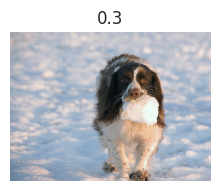

In [ ]:
get_pictures('Dog with ball')


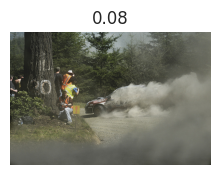

In [ ]:
get_pictures('Man siting on the tree banch')

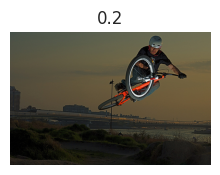

In [ ]:
get_pictures('A person reading a book')

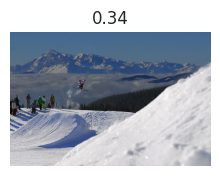

In [ ]:
get_pictures('A snowy mountain')

In [ ]:
get_pictures('Children swimming in a pool')

This image is unavailable in your country.


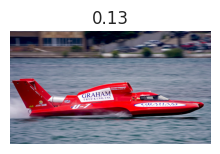

In [ ]:
get_pictures('A cat sitting')

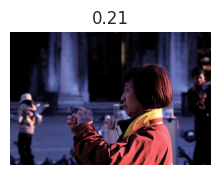

In [ ]:
get_pictures('A woman taking a photograph')

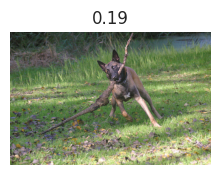

In [ ]:
get_pictures('Dogs fight')

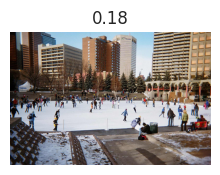

In [ ]:
get_pictures('Woman play to the guitar')

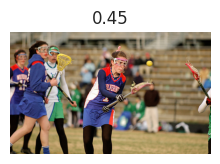

In [ ]:
get_pictures('Man play to football')

Модель неплохо справляется. Запрещенные материалы не показывает, отличает людей от животных, даже распознает действия - играть в футбол, играть на музыкальном инструменте, сидеть.

# Промежуточный вывод

**Цель:** протестировать и продемонстрировать работу модели
1. Загрузили эмбеддинги изображений и текстов тестовой выборки.
2. Загрузили лучшую модель.
3. Создали функцию `get_pictures`, которая принимает на вход текст с описанием изображения, в теле функции происходит соединение эмбеддингов, их нормализация, получение предсказания, на выход подается подходящее под описание изображение и предсказанная моделью оценка соответсвия описания изображению.

# Шаг 5. Общий вывод.

**Цель проекта:**  
Создать и выбрать лучшую модель, которая по текстовому описанию сможет находить релевантные изображения. Модель должна выдавать число от 0 до 1, показывающее степень соответствия текста и изображения, а также исключать из поиска материалы с детьми младше 16 лет.

**Задачи проекта:**  
1. Загрузка и исследовательский анализ данных.  
2. Подготовка данных к обучению.  
3. Обучение модели.  
4. Тестирование и демонстрация работы модели.  
5. Формирование итогового вывода и рекомендации.

**Выполненные действия:**  
- Загружены все исходные данные (`train_df`, `test_df`, `crowd_df`, `expert_df`, `query_df`) и проверены на пропуски и дубликаты.  
- Создан объединённый датафрейм с нормализацией оценок экспертов и краудсорсинга через взвешенное среднее (приоритет — экспертные оценки). Создан `full_train_df` для обучения модели.  
- Проведена токенизация и лемматизация текста описаний изображений с использованием Spacy; удалены стоп-слова; составлен список `danger` для фильтрации изображений с детьми, удалено 14963 строки.  
- Извлечены эмбеддинги текста (BERT all-mpnet-base-v2) и изображений (ResNet18 без последнего слоя), объединены в единый массив `X`, таргет сохранён в `y`.  
- Разделение данных на тренировочную и валидационную выборки с использованием `GroupShuffleSplit` для предотвращения утечек.  
- Обучены модели: Linear Regression, Gradient Boosting с подбором гиперпараметров через GridSearchCV, а также нейросеть с ручным подбором гиперпараметров.  
- Лучшая модель — нейросеть с одним скрытым слоем, dropout=0.4, lr=0.001, ReLU и MSELoss; RMSE на валидации = 0.193.  
- Для тестирования извлечены эмбеддинги изображений и текстов; реализована функция `get_pictures`, которая объединяет эмбеддинги, нормализует их, получает предсказание и возвращает топ-подходящее изображение с оценкой соответствия.  
- Модель успешно фильтрует запрещённые материалы, корректно различает людей и животных, распознаёт действия (играть в футбол, играть на инструменте, сидеть и т.д.).

**Впечатление:**  
Проект показал, что подход с объединением текстовых и визуальных эмбеддингов работает эффективно. Нейросеть смогла выучить соответствие описаний и изображений, при этом соблюдая ограничения по безопасности контента. Результаты демонстрируют высокую релевантность поиска и гибкость модели к различным типам запросов.

**Рекомендации:**  
- Подобрать больше успешных примеров соответсвия изображения и описания.
- Добавить распознавание детей не только в тексте, но и на изображениях.
- Внедрить автоматическую проверку и балансировку классов по типам сцен и объектов для снижения перекоса данных.  
- Добавить интерфейс интерактивного поиска, чтобы тестировать релевантность для различных текстовых описаний в реальном времени.
